In [1]:
#!pip uninstall tensorflow
#!pip install tensorflow-macos tensorflow-metal
#!pip install --upgrade torch torchvision torchaudio

In [2]:
import pickle
import pandas as pd
import tensorflow as tf
import torch
from transformers import BertTokenizer, BertModel, BertModel, GPT2Tokenizer, GPT2Model, AutoTokenizer, AutoModelForCausalLM
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from sentence_transformers import SentenceTransformer
from transformers import AutoModelForCausalLM
from bertviz import head_view, model_view

In [3]:
df=pickle.load(open("/Users/joric/Documents/NLP Project/Transformers/data/data_clean_finance.pkl", "rb"))
df.head()

,sentiment,text,clean,clean2,lemma,text_length
0,neutral,"According to Gran , the company has no plans t...",according to gran the company has no plans to ...,according gran company plans move production r...,accord gran company plan move production russi...,69
1,neutral,Technopolis plans to develop in stages an area...,technopolis plans to develop in stages an area...,technopolis plans develop stages area less squ...,technopolis plan develop stage area less squar...,129
2,negative,The international electronic industry company ...,the international electronic industry company ...,international electronic industry company elco...,international electronic industry company elco...,163
3,positive,With the new production plant the company woul...,with the new production plant the company woul...,new production plant company would increase ca...,new production plant company would increase ca...,155
4,positive,According to the company 's updated strategy f...,according to the company s updated strategy fo...,according company updated strategy years baswa...,accord company update strategy year basware ta...,113


# **Part 1: BERT, SBERT**

In [4]:
#Load the BERT tokenizer and the BERT model using the below code:
bert_uncased = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

In [5]:
#Apply the following code to transform the tokenized data in an appropriate form. Examine the first list entry.
df['bert_quick']=df['clean'].apply(lambda x: [bert_uncased.encode(x)])
df[['clean','bert_quick']][0:1]

,clean,bert_quick
0,according to gran the company has no plans to ...,"[[101, 2429, 2000, 12604, 1996, 2194, 2038, 20..."


In [6]:
# Use print(list(bert_uncased.vocab.keys())[id]) to better understand the results (id is the token id)
print(list(bert_uncased.vocab.keys()))
print(list(bert_uncased.vocab.keys())[0:5])

['[PAD]', '[unused0]', '[unused1]', '[unused2]', '[unused3]', '[unused4]', '[unused5]', '[unused6]', '[unused7]', '[unused8]', '[unused9]', '[unused10]', '[unused11]', '[unused12]', '[unused13]', '[unused14]', '[unused15]', '[unused16]', '[unused17]', '[unused18]', '[unused19]', '[unused20]', '[unused21]', '[unused22]', '[unused23]', '[unused24]', '[unused25]', '[unused26]', '[unused27]', '[unused28]', '[unused29]', '[unused30]', '[unused31]', '[unused32]', '[unused33]', '[unused34]', '[unused35]', '[unused36]', '[unused37]', '[unused38]', '[unused39]', '[unused40]', '[unused41]', '[unused42]', '[unused43]', '[unused44]', '[unused45]', '[unused46]', '[unused47]', '[unused48]', '[unused49]', '[unused50]', '[unused51]', '[unused52]', '[unused53]', '[unused54]', '[unused55]', '[unused56]', '[unused57]', '[unused58]', '[unused59]', '[unused60]', '[unused61]', '[unused62]', '[unused63]', '[unused64]', '[unused65]', '[unused66]', '[unused67]', '[unused68]', '[unused69]', '[unused70]', '[unus

In [7]:
#Convert the ids to torch tensors, required by the BERT model:
inputs = df['bert_quick'].apply(lambda x: torch.tensor(x))
print(inputs)

0       [[tensor(101), tensor(2429), tensor(2000), ten...
1       [[tensor(101), tensor(21416), tensor(17699), t...
2       [[tensor(101), tensor(1996), tensor(2248), ten...
3       [[tensor(101), tensor(2007), tensor(1996), ten...
4       [[tensor(101), tensor(2429), tensor(2000), ten...
                              ...                        
4841    [[tensor(101), tensor(2414), tensor(3006), ten...
4842    [[tensor(101), tensor(18416), tensor(2271), te...
4843    [[tensor(101), tensor(4082), tensor(5618), ten...
4844    [[tensor(101), tensor(5658), tensor(4341), ten...
4845    [[tensor(101), tensor(4341), tensor(1999), ten...
Name: bert_quick, Length: 4835, dtype: object


In [8]:
#Load the BERT model and examine its architecture:
model = BertModel.from_pretrained('bert-base-uncased')
print(type(model))
print(model)

<class 'transformers.models.bert.modeling_bert.BertModel'>
BertModel(
  (embeddings): BertEmbeddings(
    (word_embeddings): Embedding(30522, 768, padding_idx=0)
    (position_embeddings): Embedding(512, 768)
    (token_type_embeddings): Embedding(2, 768)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): BertEncoder(
    (layer): ModuleList(
      (0-11): 12 x BertLayer(
        (attention): BertAttention(
          (self): BertSdpaSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): BertSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affin

In [9]:
#What is the size of the word_embeddings? Where do the numbers come from?
size_word_emb = model.embeddings.word_embeddings.weight.shape
print(f"Size of word_embeddings: {size_word_emb}")
print(f"Number of tokens in BERT vocabulary: {size_word_emb[0]}")
print(f"Size of each token's embeddings vector (hidden size): : {size_word_emb[1]}. Each word is mapped to a {size_word_emb[1]}-dimensional vector")

Size of word_embeddings: torch.Size([30522, 768])
Number of tokens in BERT vocabulary: 30522
Size of each token's embeddings vector (hidden size): : 768. Each word is mapped to a 768-dimensional vector


In [10]:
#What is the size of the position_embeddings? Where do the numbers come from?
size_pos_emb = model.embeddings.position_embeddings.weight.shape
print(f"Size of positional embeddings: {size_pos_emb}")
print(f"Maximum sequence length: {size_pos_emb[0]}. BERT can handle up to {size_pos_emb[0]} tokens in one input. Each position from 1 to {size_pos_emb[0]} has its own learnable vector")
print(f"Size of each token's embeddings vector (hidden size): : {size_pos_emb[1]}. Each word is mapped to a {size_pos_emb[1]}-dimensional vector")

Size of positional embeddings: torch.Size([512, 768])
Maximum sequence length: 512. BERT can handle up to 512 tokens in one input. Each position from 1 to 512 has its own learnable vector
Size of each token's embeddings vector (hidden size): : 768. Each word is mapped to a 768-dimensional vector


In [11]:
# Count the number of encoder layers
encoder_layers = model.encoder.layer
print(type(encoder_layers))
print(f"Number of encoder layers: {len(encoder_layers)}")
print(model.config.num_hidden_layers)

<class 'torch.nn.modules.container.ModuleList'>
Number of encoder layers: 12
12


In [12]:
# Look at (0): BertLayer. What does it consist of (not every detail, just main parts)?
layer0 = model.encoder.layer[0]
print(layer0)
print('-------------')
print('1. Self-attention sub-layer: Allow each token to look at other tokens in the sentence --> Learn how important other words are to the current word')
print('2. Intermediate Feed-Forward Layer: Transform the output from attention layer into a richer representation. Expand 768 dimensions to 3072 dimensions')
print('3. Output Feed-Forward Sub-layer: Bring dimensionality back to 768 dimensions from 3072 dimensions. Normalize the layer. Stabilize and retain orignal information')

BertLayer(
  (attention): BertAttention(
    (self): BertSdpaSelfAttention(
      (query): Linear(in_features=768, out_features=768, bias=True)
      (key): Linear(in_features=768, out_features=768, bias=True)
      (value): Linear(in_features=768, out_features=768, bias=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (output): BertSelfOutput(
      (dense): Linear(in_features=768, out_features=768, bias=True)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
  )
  (intermediate): BertIntermediate(
    (dense): Linear(in_features=768, out_features=3072, bias=True)
    (intermediate_act_fn): GELUActivation()
  )
  (output): BertOutput(
    (dense): Linear(in_features=3072, out_features=768, bias=True)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
)
-------------
1. Self-attention sub-layer: Allow each token to look at other 

In [13]:
#What do you think is the BertPooler doing?

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Sample input
text = df['clean'][0]
input_demo = tokenizer(text, return_tensors="pt")

# Forward pass
output_demo = model(**input_demo)

# 1. Sequence output (hidden states for each token)
last_hidden_state = output_demo.last_hidden_state

# 2. Pooled output (from BertPooler)
pooled_output = output_demo.pooler_output

print(f"Shape of last_hidden_state: {last_hidden_state.shape}")
print(f"Input batch size: {last_hidden_state.shape[0]}. Sequence length (Token count): {last_hidden_state.shape[1]}")
print(f"Token list: {tokenizer.convert_ids_to_tokens(input_demo['input_ids'][0])}")
print(f"BERT embbeding size: {last_hidden_state.shape[2]} --> → Each token in each sentence has its own contextual {last_hidden_state.shape[2]}-dim vector.")
print(f"last_hidden_state: {last_hidden_state[0]}")
print('--------------')
print(f"Shape of pooled_output: {pooled_output.shape}")
print(f"Input batch size: {pooled_output.shape[0]}")
print(f"Pulled sentence vector: {pooled_output.shape[1]} --> a single embbeding of {pooled_output.shape[1]}-dim vector for each sentence")
print(f"pooled_output[0][:3]: {pooled_output[0][:3]}. This is transformed from {last_hidden_state[0][0][:3]}")
print('--------------')
print('last_hidden_state: Hidden vectors for all tokens in the input (1 vector per token)')
print('pooled_output: A single vector summarizing the sentence — output of BertPooler')
print('--------------')
print('BertPooler: take the embbedings (vector) of the [CLS] token of a single input sequence')
print("For input i, the pooler_output[i] is generated from: last_hidden_state[i][0] --> the [CLS] token's final hidden state, then apply further transformation.")
print("""Why it can summarize the whole sentence?: Because of self-attention, the [CLS] token attends all other tokens in the sentence.
The [CLS] vector is updated at every layer. After 12 layers, the [CLS] vector becomes a summary """)

Shape of last_hidden_state: torch.Size([1, 24, 768])
Input batch size: 1. Sequence length (Token count): 24
Token list: ['[CLS]', 'according', 'to', 'gran', 'the', 'company', 'has', 'no', 'plans', 'to', 'move', 'all', 'production', 'to', 'russia', 'although', 'that', 'is', 'where', 'the', 'company', 'is', 'growing', '[SEP]']
BERT embbeding size: 768 --> → Each token in each sentence has its own contextual 768-dim vector.
last_hidden_state: tensor([[-0.1400,  0.1541,  0.2206,  ..., -0.4945,  0.1702,  0.2349],
        [ 0.6029, -0.0050,  0.1562,  ..., -0.3444,  0.5314, -0.8858],
        [-0.0660,  0.2957,  0.1879,  ..., -0.5376,  0.2879, -0.4334],
        ...,
        [-0.3301, -0.5022, -0.0563,  ..., -0.4448,  0.4135, -0.1140],
        [-0.3526, -0.8550,  0.0382,  ...,  0.4922,  0.4336, -0.5962],
        [ 0.4496, -0.0229,  0.0023,  ..., -0.4862, -0.4577, -0.6234]],
       grad_fn=<SelectBackward0>)
--------------
Shape of pooled_output: torch.Size([1, 768])
Input batch size: 1
Pulled s

In [14]:
#Apply the BERT model to the prepared text of the first document using:
with torch.no_grad():
  outputs = model(inputs[0], output_attentions=True)
  embeddings_all = outputs.last_hidden_state.numpy()
  embeddings = outputs.last_hidden_state[0][0].numpy()

#Examine embeddings_all and embeddings. What is their size? Where do the numbers come from?
print(f"inputs[0]: {inputs[0]}")
print(f"Size of embeddings_all: {embeddings_all.shape} --> {embeddings_all.shape[0]} input. {embeddings_all.shape[1]} token count. {embeddings_all.shape[2]}-dim vector")
print(f"Size of embeddings: {embeddings.shape} --> embbeding vector of the [CLS] token has {embeddings.shape[0]} dimensions")

#Run the following code and examine the result:
attention_weights = outputs.attentions
head_view(attention_weights, tokens=bert_uncased.convert_ids_to_tokens(inputs[0][0]))

BertSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


inputs[0]: tensor([[  101,  2429,  2000, 12604,  1996,  2194,  2038,  2053,  3488,  2000,
          2693,  2035,  2537,  2000,  3607,  2348,  2008,  2003,  2073,  1996,
          2194,  2003,  3652,   102]])
Size of embeddings_all: (1, 24, 768) --> 1 input. 24 token count. 768-dim vector
Size of embeddings: (768,) --> embbeding vector of the [CLS] token has 768 dimensions


<IPython.core.display.Javascript object>

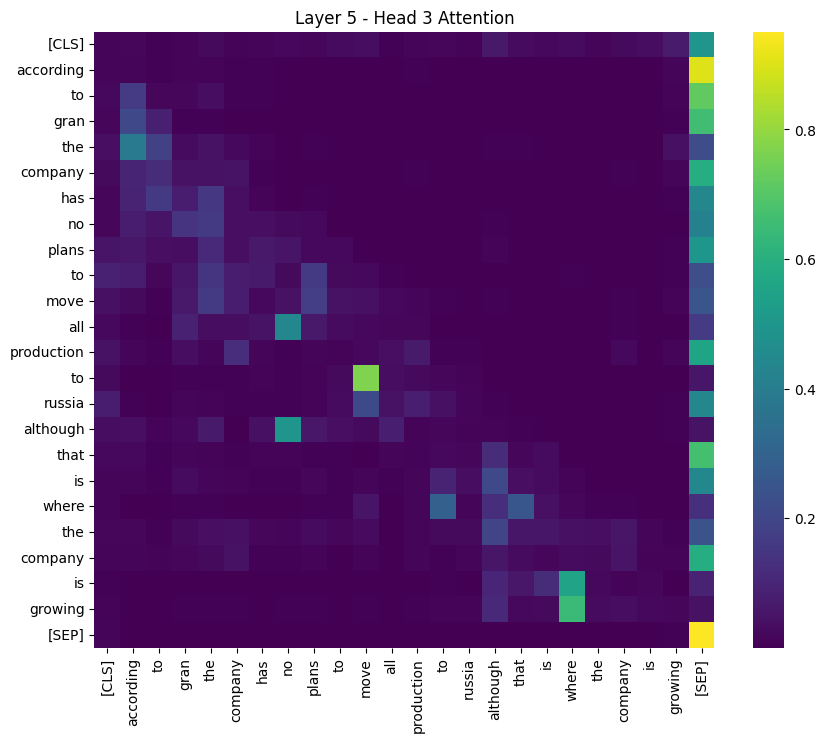

In [15]:
# Layer 5 (0-11), Head 3 (0-11)
layer = 5
head = 3

# Shape: (1, num_heads=12, seq_len, seq_len)
attn_matrix = attention_weights[layer][0][head].detach().numpy()

# Convert token IDs to readable tokens
tokens = bert_uncased.convert_ids_to_tokens(inputs[0][0])

# Create DataFrame
attn_df = pd.DataFrame(attn_matrix, columns=tokens, index=tokens)

# Display top of the table
attn_df.head(10)

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
sns.heatmap(attn_df, cmap="viridis", xticklabels=True, yticklabels=True)
plt.title(f"Layer {layer} - Head {head} Attention")
plt.xticks(rotation=90)
plt.show()

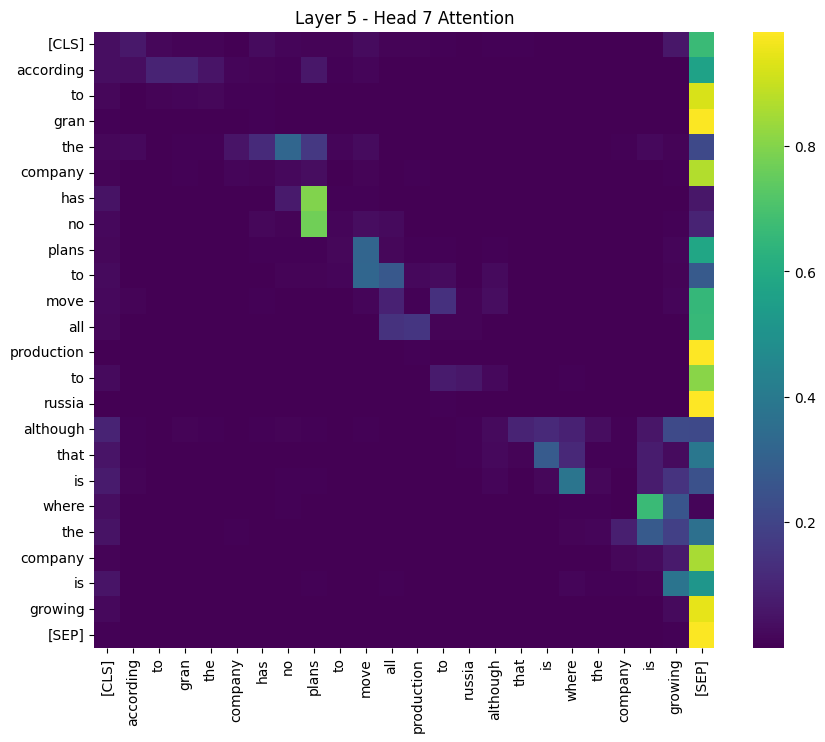

In [16]:
# Layer 5 (0-11), Head 7 (0-11)
layer = 5
head = 7

# Shape: (1, num_heads=12, seq_len, seq_len)
attn_matrix = attention_weights[layer][0][head].detach().numpy()

# Convert token IDs to readable tokens
tokens = bert_uncased.convert_ids_to_tokens(inputs[0][0])

# Create DataFrame
attn_df = pd.DataFrame(attn_matrix, columns=tokens, index=tokens)

plt.figure(figsize=(10, 8))
sns.heatmap(attn_df, cmap="viridis", xticklabels=True, yticklabels=True)
plt.title(f"Layer {layer} - Head {head} Attention")
plt.xticks(rotation=90)
plt.show()

In [17]:
'''
Layer 5 - Head 3: "to" attends strongly to "move"
Layer 5 - Head 7: "has" and "no" attends strongly to "plans"
'''

'\nLayer 5 - Head 3: "to" attends strongly to "move"\nLayer 5 - Head 7: "has" and "no" attends strongly to "plans"\n'

In [18]:
#Use the below method prepare_apply_model(tokenizer, text, model, length) which takes as inputs the tokenizer (here bert_uncased),
#the text (e.g. df['clean'].loc[0]), the model (here model) generates the BERT embedding for the CLS token.
def prepare_apply_model(tokenizer, text, model):
  input=torch.tensor([tokenizer.encode(text)])
  with torch.no_grad():
    outputs = model(input)
  embeddings = outputs.last_hidden_state[0][0].numpy()
  return embeddings

print(prepare_apply_model(bert_uncased,df['clean'].loc[0],model).shape)
print(prepare_apply_model(bert_uncased,df['clean'].loc[0],model)[0:12])

(768,)
[-0.1399881   0.15410912  0.22062464 -0.43823928 -0.14068311 -0.15129322
  0.19675365  0.84317136 -0.23946595 -0.08361468 -0.02050287 -0.5567848 ]


In [19]:
#Apply the above method to the first 100 documents measuring time using:
import time
start = time.time()
embeddings=df['clean'].loc[0:100].apply(lambda x:prepare_apply_model(bert_uncased, x, model))
end = time.time()
print(end - start)

4.905901908874512


In [20]:
import tensorflow as tf
print("TF version:", tf.__version__)
print("Metal plugin:", tf.config.list_physical_devices('GPU'))

TF version: 2.19.0
Metal plugin: []


In [21]:
import tensorflow as tf
print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.19.0
[]


In [22]:
# Choose cuda:0 if available, otherwise fall back to CPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == 'cuda':
    print(f"There are {torch.cuda.device_count()} GPU(s) available.")
    print("We will use the GPU:", torch.cuda.get_device_name(0))
else:
    print("No GPU available, using the CPU instead.")

No GPU available, using the CPU instead.


In [23]:
#Write prepare_apply_model_GPU(tokenizer, text, model) by adding model.to(device) and input.to(device) to prepare_apply_model(tokenizer, text, model).
def prepare_apply_model_GPU(tokenizer, text, model):
    input = torch.tensor([tokenizer.encode(text)]).to(device)  # move input to GPU
    model = model.to(device)  # move model to GPU

    with torch.no_grad():
        outputs = model(input)

    embeddings = outputs.last_hidden_state[0][0].cpu().numpy()  # move to CPU before .numpy()
    return embeddings

import time
start = time.time()
embeddings=df['clean'].loc[0:100].apply(lambda x:prepare_apply_model_GPU(bert_uncased, x, model))
end = time.time()
print(end - start)
print(embeddings[0].shape)
print(embeddings[0][0:12])

4.9614949226379395
(768,)
[-0.1399881   0.15410912  0.22062464 -0.43823928 -0.14068311 -0.15129322
  0.19675365  0.84317136 -0.23946595 -0.08361468 -0.02050287 -0.5567848 ]


In [24]:
#Repeat using SBERT instead. Note that here you do not need an extra tokenizer.
#You can use the following code for help
model_sbert_bert = SentenceTransformer('bert-base-nli-cls-token')
#Check the model structure
print(model_sbert_bert)

SentenceTransformer(
  (0): Transformer({'max_seq_length': 128, 'do_lower_case': False}) with Transformer model: BertModel 
  (1): Pooling({'word_embedding_dimension': 768, 'pooling_mode_cls_token': True, 'pooling_mode_mean_tokens': False, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
)


In [25]:
#Do the embeddings differ from those from BERT?
def prepare_apply_model_GPU_SBERT(model, text):
  model.to(device)
  with torch.no_grad():
    embeddings = model.encode(text, convert_to_tensor=True).to(device)
  return embeddings.cpu().numpy()

embeddings_sbert = df['clean'].loc[0:100].apply(lambda x:prepare_apply_model_GPU_SBERT(model_sbert_bert, x))

start = time.time()
embeddings=df['clean'].loc[0:100].apply(lambda x:prepare_apply_model_GPU_SBERT(model_sbert_bert, x))
end = time.time()
print(end - start)
print(embeddings[0].shape)
print(embeddings[0][0:12])

3.7624967098236084
(768,)
[-0.11616388 -0.27216506  1.4864247  -0.06844244  0.40547228 -0.11206882
  1.3160588   1.2545221  -0.48904583 -0.34915176 -0.34117535 -0.7606086 ]


# **Part 2: GPT-2, Llama**

In [26]:
#Load the GPT model and the tokenizer, using:
tokenizer_GPT = GPT2Tokenizer.from_pretrained("gpt2")
model_GPT = GPT2Model.from_pretrained('gpt2')
#Examine the model structure.
print(model_GPT)

GPT2Model(
  (wte): Embedding(50257, 768)
  (wpe): Embedding(1024, 768)
  (drop): Dropout(p=0.1, inplace=False)
  (h): ModuleList(
    (0-11): 12 x GPT2Block(
      (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (attn): GPT2Attention(
        (c_attn): Conv1D(nf=2304, nx=768)
        (c_proj): Conv1D(nf=768, nx=768)
        (attn_dropout): Dropout(p=0.1, inplace=False)
        (resid_dropout): Dropout(p=0.1, inplace=False)
      )
      (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (mlp): GPT2MLP(
        (c_fc): Conv1D(nf=3072, nx=768)
        (c_proj): Conv1D(nf=768, nx=3072)
        (act): NewGELUActivation()
        (dropout): Dropout(p=0.1, inplace=False)
      )
    )
  )
  (ln_f): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
)


In [27]:
#Tokenise the first text (df['clean'].loc[0]).
#Apply the model to the result and examine its attention similar to 6.
#What is the difference to BERT?

inputs_GPT = tokenizer_GPT(df['clean'].loc[0], return_tensors="pt")

with torch.no_grad():
  outputs_GPT = model_GPT(**inputs_GPT, output_attentions=True)
embeddings_all_GPT = outputs.last_hidden_state.numpy()
embeddings_GPT = outputs.last_hidden_state[0] [0].numpy()

attention_weights_GPT = outputs_GPT.attentions
print(len(attention_weights_GPT))
print(attention_weights_GPT[0].shape)
head_view(attention_weights_GPT, tokens=tokenizer_GPT.convert_ids_to_tokens(inputs_GPT.input_ids[0]))

`torch.nn.functional.scaled_dot_product_attention` does not support `output_attentions=True`. Falling back to eager attention. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


12
torch.Size([1, 12, 24, 24])


<IPython.core.display.Javascript object>

In [28]:
#Run GPT with CPU
start = time.time()
embeddings_GPT=df['clean'].loc[0:100].apply(lambda x:prepare_apply_model(tokenizer_GPT, x, model_GPT))
end = time.time()
print(end - start)

4.490952968597412


In [29]:
#Run GPT with GPU
start = time.time()
embeddings_GPT=df['clean'].loc[0:100].apply(lambda x:prepare_apply_model_GPU(tokenizer_GPT, x, model_GPT))
end = time.time()
print(end - start)
print(embeddings_GPT[0].shape)
print(embeddings_GPT[0][0:12])

4.524083137512207
(768,)
[ 0.00101576  0.16952518 -0.49059123  0.01647149  0.07766142 -0.26308832
  0.9829794   0.07145432 -0.17080589  0.0586945   0.4550888   0.02008582]


In [35]:
from huggingface_hub import login
import os
login(token=os.getenv("HF_TOKEN"))

In [37]:
import pickle
import torch
from transformers import AutoTokenizer, AutoModelForCausalLM

# 1) Load your data
df = pickle.load(open(
    "/Users/joric/Documents/NLP Project/Transformers/data/data_clean_finance.pkl", "rb"
))

model_name = "meta-llama/Llama-2-7b-hf"

# 2) Load tokenizer (with your HF token)
tokenizer = AutoTokenizer.from_pretrained(model_name, use_auth_token=True)

# ADD THIS LINE - Llama doesn't have a pad_token by default
tokenizer.pad_token = tokenizer.eos_token

# 3) Load model in fp16 (no device_map)
model = AutoModelForCausalLM.from_pretrained(
    model_name,
    use_auth_token=True,
    torch_dtype=torch.float16,
    low_cpu_mem_usage=True
)

# 4) Move the entire model to MPS
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
model.to(device)

# 5) Tokenize & move inputs
text = df["clean"].iloc[0]
inputs = tokenizer(
    text,
    return_tensors="pt",
    truncation=True,
    padding="max_length",
    max_length=512
)
inputs = {k: v.to(device) for k, v in inputs.items()}

# 6) Forward pass & extract last_hidden_state
with torch.no_grad():
    outputs = model(**inputs, output_hidden_states=True)
    last_hidden = outputs.hidden_states[-1]  # Get the last layer's hidden states

# 7) Grab the BOS-token embedding
embedding_bos = last_hidden[0, 0].cpu().numpy()
print("BOS embedding shape:", embedding_bos.shape)

/Users/joric/Documents/NLP Project/Transformers/.venv/lib/python3.11/site-packages/transformers/models/auto/tokenization_auto.py:902: FutureWarning: The `use_auth_token` argument is deprecated and will be removed in v5 of Transformers. Please use `token` instead.
  warnings.warn(
/Users/joric/Documents/NLP Project/Transformers/.venv/lib/python3.11/site-packages/transformers/models/auto/auto_factory.py:476: FutureWarning: The `use_auth_token` argument is deprecated and will be removed in v5 of Transformers. Please use `token` instead.
  warnings.warn(


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

BOS embedding shape: (4096,)


In [ ]:
attention_weights = outputs.attentions
head_view(attention_weights,tokens=tokenizer.convert_ids_to_tokens(inputs_llama['input_ids'][0]))

<IPython.core.display.Javascript object>